<br>

# 목차

<br>

##### 라이브러리

## ○ 서울시 자전거 교통사고 발생현황

### 1. 10년간 사고 발생현황
### 2. 지역별 사고 발생현황

<br>

## ○ 교통사고 통계분석

### 1. 인구수 관련 사고발생
### 2. 도로수 관련 사고발생
#### 2-1. 인구수 대비 도로수 시각화

<br>

### 3. 대여건수 관련 사고발생
### 4. 도로종류 관련 사고발생
### 5. 도로지도 & 사고다발지역

<br>

## ○ 데이터 스케일링
### 1. 점수화
### 2. p-value

<br>

# 결론

<br>

#### 라이브러리

In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import folium
import branca
import json
import requests
import googlemaps
import plotly
import plotly.graph_objs as go

from bs4 import BeautifulSoup # HTTP Response -> HTML
from matplotlib import font_manager, rc # rc == run configure(configuration file)
from branca.colormap import linear
from folium.features import DivIcon
from scipy import stats
from sklearn.datasets import load_iris


%matplotlib inline 
font_name = font_manager.FontProperties(fname="c:/Windows/Fonts/malgun.ttf").get_name() # 여백 X 한글 X
rc('font', family=font_name) # run configure

<br>

# 서울시 자전거 교통사고 발생현황


## 1. 10년간 사고 발생현황

연도별 자전거 사고 발생 수 데이터

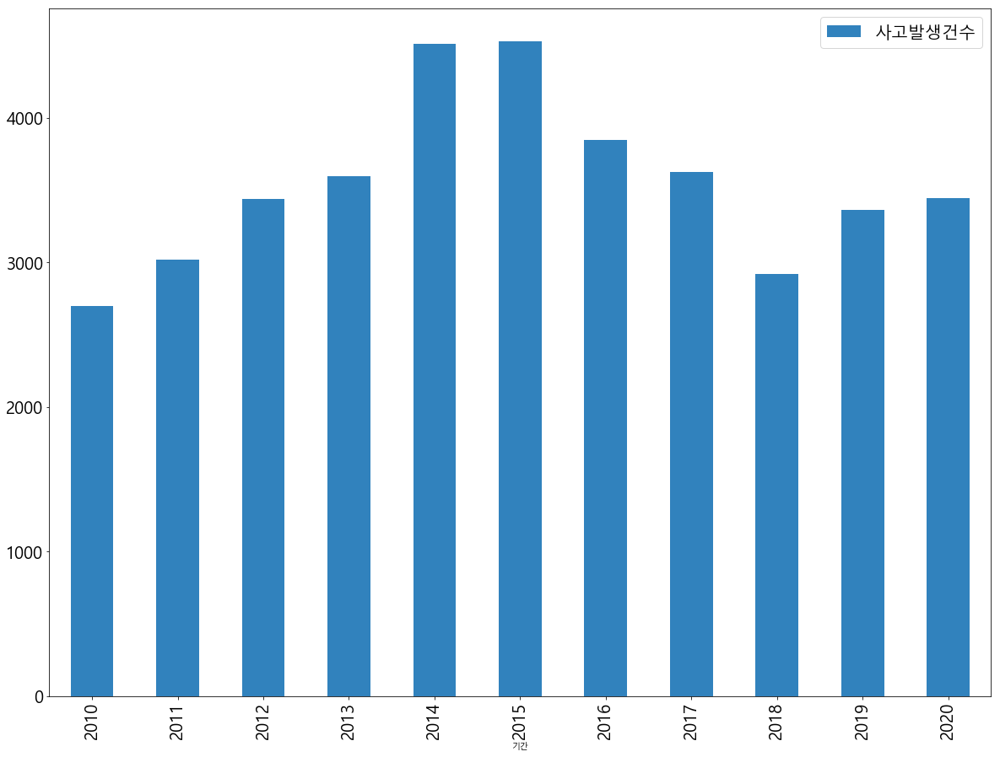

In [2]:
acc_inc = pd.read_excel('data/yong/연도별자전거사고증가.xlsx', encoding='UTF-8', index_col='기간')
acc_inc.plot(kind='bar', figsize=(20, 15), fontsize=20, colormap='tab20c').legend(fontsize = 20)
plt.savefig('연도별자전거사고.png')

자전거 교통사고 현황 데이터

In [3]:
bicycle_acc_df = pd.read_excel('data\lee\자전거교통사고현황.xlsx', encoding='utf-8')

# 무의미한 행, 열 삭제
bicycle_acc_df.drop(['기간'], axis = 1, inplace = True)
bicycle_acc_df.drop(index = [0, 1], axis = 0, inplace = True)
bicycle_acc_df.dropna(inplace = True)

# 컬럼명 변경
bicycle_acc_df.rename(columns = {'자전거 가해자사고':'가해자사고 발생건수',
                                 'Unnamed: 3':'가해자사고 사망자수',
                                 'Unnamed: 4':'가해자사고 부상자수',
                                 '자전거 피해자사고':'피해자사고 발생건수',
                                 'Unnamed: 6':'피해자사고 사망자수',
                                 'Unnamed: 7':'피해자사고 부상자수'}, inplace=True)
bicycle_acc_df.replace('-', 0, inplace = True)

# 사고발생건수(가해 + 피해) 합계
bicycle_acc_df['사고 발생건수'] = bicycle_acc_df['가해자사고 발생건수'] + bicycle_acc_df['피해자사고 발생건수']
# bicycle_acc_df.loc['서울시'] = bicycle_acc_df.sum()

# 인덱스 설정
bicycle_acc_df.set_index('지역', inplace=True)
bicycle_acc_df.head()

,가해자사고 발생건수,가해자사고 사망자수,가해자사고 부상자수,피해자사고 발생건수,피해자사고 사망자수,피해자사고 부상자수,사고 발생건수
지역,,,,,,,
종로구,20,1,23,23,0,23,43
중구,20,0,21,17,0,17,37
용산구,18,0,22,25,0,27,43
성동구,93,1,102,74,0,85,167
광진구,45,0,48,47,0,49,92


<br>

## 2. 지역별 사고 발생현황

서울시 구별 자전거 사고 그래프

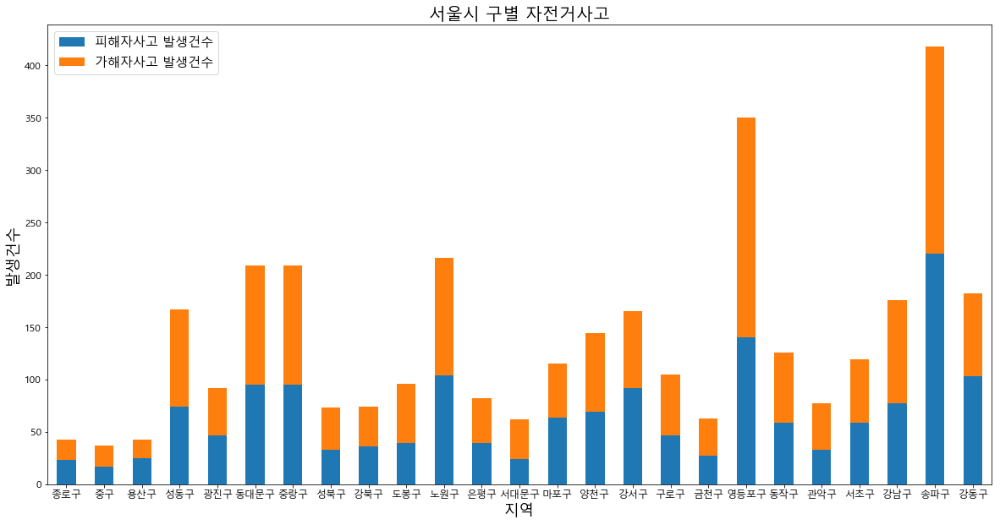

In [4]:
bicycle_acc_df_1_plt = bicycle_acc_df[['피해자사고 발생건수', '가해자사고 발생건수']]

bicycle_acc_df_1_plt.plot.bar(figsize = (20, 10),
                            fontsize = 12,
                            rot = 0,
                            stacked = True)

plt.title('서울시 구별 자전거사고', fontsize = 20)
plt.xlabel('지역', fontsize = 18)
plt.ylabel('발생건수', fontsize = 18)

plt.legend(fontsize = 15)
plt.savefig('구별자전거사고.png')

---

<br>

# 교통사고 통계분석


## 1. 인구수 관련 사고발생

서울시 자전거도로 현황 데이터

In [5]:
bicycle_road_df = pd.read_excel('data\lee\서울시_자전거도로현황.xlsx', encoding='utf-8')


# 무의미한 행과 열 삭제
bicycle_road_df.drop(['기간', '자치구'], axis =1, inplace=True)
bicycle_road_df.drop(index = [2, 28, 29, 30, 31], axis =0, inplace=True)
bicycle_road_df.dropna(inplace=True)

# 컬럼명 변경
bicycle_road_df.rename(columns = {'자치구(2)':'지역',
                                  '합계':'자전거도로 합계 구간',
                                  'Unnamed: 4':'자전거도로 합계 길이',
                                  '자전거전용도로':'자전거전용도로 구간',
                                  'Unnamed: 6':'자전거전용도로 길이',
                                  '자전거보행자겸용도로':'자전거보행자겸용도로 구간',
                                  'Unnamed: 8':'자전거보행자겸용도로 길이',
                                  '자전거전용차로':'자전거전용차로 구간',
                                  'Unnamed: 10':'자전거전용차로 길이',
                                  '자전거우선도로':'자전거우선도로 구간',
                                  'Unnamed: 12':'자전거우선도로 길이'}, inplace=True)

bicycle_road_df.replace('-', 0, inplace=True)

# 인덱스 설정
bicycle_road_df.set_index('지역', inplace=True)

bicycle_road_df.head()

,자전거도로 합계 구간,자전거도로 합계 길이,자전거전용도로 구간,자전거전용도로 길이,자전거보행자겸용도로 구간,자전거보행자겸용도로 길이,자전거전용차로 구간,자전거전용차로 길이,자전거우선도로 구간,자전거우선도로 길이
지역,,,,,,,,,,
종로구,38,26.5,0,0.0,9,9.5,13,6.9,16,10.2
중구,18,15.3,0,0.0,4,4.6,0,0.0,14,10.7
용산구,26,33.0,5,2.0,11,10.6,0,0.0,10,20.4
성동구,31,27.2,1,0.3,18,16.9,3,2.0,9,8.0
광진구,50,46.8,1,0.2,43,41.7,1,0.3,5,4.6


인구 수 데이터

In [6]:
popul_df = pd.read_csv('data\lee\pop_kor.csv', encoding='UTF-8', index_col='구별')

# 단위 변경 (만)
popul_df['인구수'] =popul_df['인구수'] / 10000
popul_df.rename(columns = {'인구수':'인구수(만)'}, inplace=True)
popul_df.head()

,인구수(만)
구별,
강남구,58.1760
강동구,46.3321
강북구,33.4426
강서구,59.5691
관악구,52.9031


공공자전거 대여소별 이용정보 데이터

In [7]:
bicycle_using_df = pd.read_excel('data\lee\공공자전거 대여소별 이용정보_202006.csv', encoding='utf-8')

# 데이터 전처리
bicycle_using_df = bicycle_using_df.drop(['대여소 명', '대여 일자 / 월'], axis =1)
bicycle_using_df.rename(columns = {'대여소 그룹':'지역'}, inplace = True)
bicycle_using_df = bicycle_using_df.groupby(bicycle_using_df['지역']).sum()

# 단위 변경(만)
bicycle_using_df['대여 건수'] =bicycle_using_df['대여 건수'] / 10000
bicycle_using_df.rename(columns = {'대여 건수':'대여건수(만)'}, inplace=True)

bicycle_using_df.head()

,대여건수(만)
지역,
강남구,9.2905
강동구,11.1698
강북구,5.4179
강서구,23.2192
관악구,10.1026


전체 데이터 통합된 데이터프레임 생성

In [8]:
total_df = pd.concat([bicycle_road_df, bicycle_acc_df, popul_df, bicycle_using_df], axis =1)
total_df.dropna(inplace=True)

total_df.head()

D:\Programing\Anaconda\lib\site-packages\ipykernel_launcher.py:1: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  """Entry point for launching an IPython kernel.


,자전거도로 합계 구간,자전거도로 합계 길이,자전거전용도로 구간,자전거전용도로 길이,자전거보행자겸용도로 구간,자전거보행자겸용도로 길이,자전거전용차로 구간,자전거전용차로 길이,자전거우선도로 구간,자전거우선도로 길이,가해자사고 발생건수,가해자사고 사망자수,가해자사고 부상자수,피해자사고 발생건수,피해자사고 사망자수,피해자사고 부상자수,사고 발생건수,인구수(만),대여건수(만)
강남구,65.0,90.0,7.0,11.9,54.0,75.1,4.0,3.0,0.0,0.0,99.0,0.0,117.0,77.0,0.0,91.0,176.0,58.1760,9.2905
강동구,66.0,72.0,17.0,17.5,48.0,53.9,1.0,0.6,0.0,0.0,79.0,3.0,84.0,103.0,0.0,108.0,182.0,46.3321,11.1698
강북구,8.0,8.7,0.0,0.0,3.0,3.2,5.0,5.5,0.0,0.0,38.0,0.0,43.0,36.0,0.0,36.0,74.0,33.4426,5.4179
강서구,80.0,76.4,36.0,31.9,44.0,44.5,0.0,0.0,0.0,0.0,73.0,0.0,79.0,92.0,2.0,97.0,165.0,59.5691,23.2192
관악구,19.0,29.5,3.0,4.7,8.0,21.4,0.0,0.0,8.0,3.4,44.0,1.0,43.0,33.0,2.0,32.0,77.0,52.9031,10.1026


인구 수 대비(만 단위) 사고율 계산

In [9]:
acc_ratio_pop = total_df["사고 발생건수"] / total_df['인구수(만)']
total_df_arp = total_df[['인구수(만)']]
total_df_arp['인구수대비 사고율'] = acc_ratio_pop *10

total_df_arp = total_df_arp.sort_values(by = '인구수(만)', ascending=False)
total_df_arp.head()

D:\Programing\Anaconda\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,인구수(만),인구수대비 사고율
송파구,66.7480,62.623599
강서구,59.5691,27.698924
강남구,58.1760,30.253025
노원구,57.8221,37.355959
관악구,52.9031,14.554913


인구 수 대비 사고율 그래프

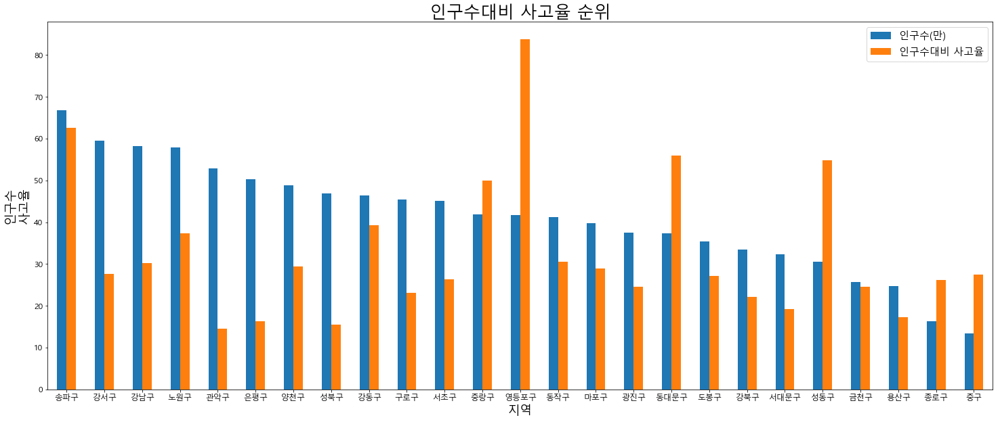

In [10]:
total_df_arp.plot.bar(figsize=(25, 10),
                      fontsize =12,
                      rot =0)

plt.title('인구수대비 사고율 순위', fontsize =25)
plt.xlabel('지역', fontsize=18)
plt.ylabel('인구수\n사고율', fontsize=18)

plt.legend(fontsize = 15)
plt.savefig('인구수대비사고율.png')

<br>

## 2. 도로수 관련 사고발생

In [11]:
total_df_arrn = total_df[['자전거도로 합계 구간', '사고 발생건수']]
total_df_arrn = total_df_arrn.sort_values(by = '자전거도로 합계 구간', ascending=False)

total_df_arrn.head()

,자전거도로 합계 구간,사고 발생건수
송파구,186.0,418.0
영등포구,82.0,350.0
강서구,80.0,165.0
강동구,66.0,182.0
강남구,65.0,176.0


자전거 도로 수 & 사고 건수 그래프

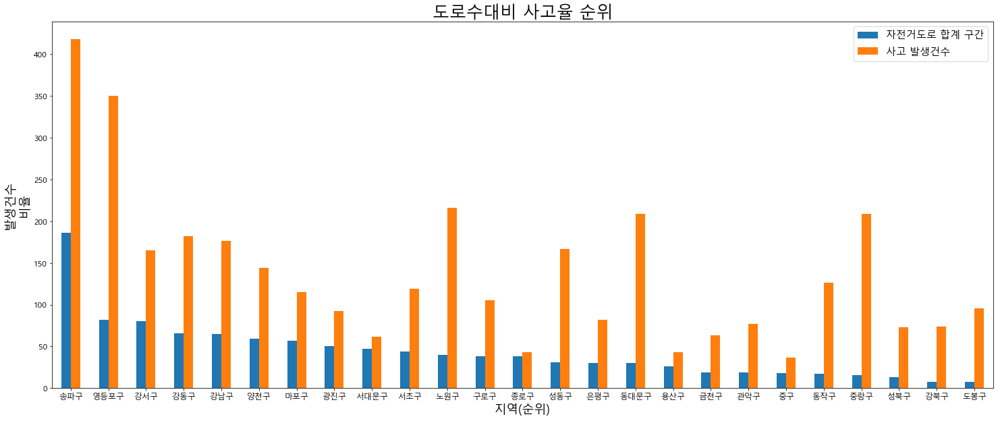

In [12]:
total_df_arrn.plot.bar(figsize = (25, 10),
                       fontsize = 12,
                       rot = 0)

plt.title('도로수대비 사고율 순위', fontsize = 25)
plt.xlabel('지역(순위)', fontsize = 18)
plt.ylabel('발생건수\n비율', fontsize = 18)

plt.legend(fontsize = 15)
plt.savefig('도로수대비사고율.png')

<br>

## 2-1. 인구수 대비 도로수 시각화

데이터 전처리

In [13]:
df = pd.read_excel('data/yong/서울시_자전거도로현황.xlsx', encoding='utf-8') 


# 멀티인덱스 삭제 / 열정리
df.drop(['기간', '자치구', 'Unnamed: 4', 'Unnamed: 6', 'Unnamed: 8', 'Unnamed: 10', 'Unnamed: 12'], axis=1, inplace=True)

# 무의미한 행 제거
df =  df.drop(df.index[0:3])
df =  df.drop(df.index[25:30])

# 피봇테이블 기준열 열이름 변경
df.rename(columns = {"자치구(2)" : "구별"}, inplace=True)

# 피벗테이블
bicycle_load = pd.pivot_table(df, index='구별', aggfunc=np.sum)

# 전처리
bicycle_load = bicycle_load[['자전거보행자겸용도로','자전거우선도로','자전거전용도로','자전거전용차로','합계']].astype(object)
bicycle_load [bicycle_load[['자전거보행자겸용도로', '자전거우선도로', '자전거전용도로', '자전거전용차로', '합계']] == '-'] = 0

# data scaling
target_col = ['합계', '자전거전용도로', '자전거보행자겸용도로', '자전거전용차로','자전거우선도로']
weight_col = bicycle_load[target_col].sum()

bicycle_load_norm = bicycle_load[target_col] / weight_col

# 인구 수 데이터
popul_df = pd.read_csv('data/yong/pop_kor.csv', encoding='UTF-8', index_col='구별')

# join
bicycle_load = bicycle_load.join(popul_df)

# 인구 수 대비 도로 수 계산
bicycle_load_ratio = bicycle_load_norm.div( bicycle_load['인구수'] , axis=0 ) * 100000 

# geo 데이터 read
geo_path = 'data/yong/skorea_municipalities_geo_simple.json'
geo_str = json.load(open(geo_path, encoding='utf-8'))

# 구글맵 API 사용하여 각 구의 위치 확인(x)
gmaps = googlemaps.Client(key="#")

lat = []
lng = []

for name in df['구별']:
    tmpMap = gmaps.geocode(name) 
    tmpLoc = tmpMap[0].get('geometry') 
    lat.append(tmpLoc['location']['lat']) 
    lng.append(tmpLoc['location']['lng'])
    
df['위도'] = lat
df['경도'] = lng

df

,구별,합계,자전거전용도로,자전거보행자겸용도로,자전거전용차로,자전거우선도로,위도,경도
3,종로구,38,-,9,13,16,37.572950,126.979358
4,중구,18,-,4,-,14,37.564091,126.997940
5,용산구,26,5,11,-,10,37.538427,126.965444
6,성동구,31,1,18,3,9,37.563341,127.037103
7,광진구,50,1,43,1,5,37.538484,127.082294
8,동대문구,30,4,12,-,14,37.574368,127.040019
9,중랑구,16,7,9,-,-,37.606560,127.092652
10,성북구,13,5,5,2,1,37.589116,127.018215
11,강북구,8,-,3,5,-,37.639610,127.025657
12,도봉구,8,2,6,-,-,37.668774,127.047071


구 별 중심 좌표 데이터

In [14]:
gu_geo = pd.read_excel('data/yong/구별위도경도.xlsx', encoding='UTF-8')

인구 수 팝업과 구 별 도로 수 시각화

In [40]:
map = folium.Map(location=[37.5502, 126.982], zoom_start=11, tiles='Stamen Toner')



# choropleth : Choropleth map @ https://goo.gl/yrTRHU
map.choropleth(geo_data = geo_str, # 서울시 행정구역별 polygon drawing
               data = bicycle_load_ratio['합계'], # 시각화의 대상이 될 데이터
               columns = [bicycle_load_ratio.index, bicycle_load_ratio['합계']],
               fill_color = 'YlGnBu', 
               key_on = 'feature.id',
               legend_name = '서울시 자전거 도로현황 인구수 대비 가중치설정'
              ) # GeoJSON 규약을 따름, json 파일(지도 데이터)의 "feature" type의 "id" 에 매칭된다

legend_html = """
<div style="position:fixed;
     color : black;
     bottom: 50px; 
     left: 50px; 
     width: 140px; 
     height: 110px; 
     border:2px solid grey; 
     z-index: 9999;
     font-size:14px;">
     &nbsp;<b>Positive Cases:</b><br>
     &nbsp;<i class="fa fa-circle fa-1x" style="color:green"></i>&nbsp인구수 10만이상<br>
     &nbsp;<i class="fa fa-circle fa-1x" style="color:orange"></i>&nbsp;인구수 20만이상<br>
     &nbsp;<i class="fa fa-circle fa-1x" style="color:#40e0d0 "></i>&nbsp;인구수 40만이상<br>
     &nbsp;<i class="fa fa-circle fa-1x" style="color:red"></i>&nbsp;인구수 50만이상<br>
</div>
"""

map.get_root().html.add_child(folium.Element(legend_html))


lat = ""
lng = ""

for i in range(25):
    name = gu_geo['구별'][i]
    lat = gu_geo['lat'][i]
    lng = gu_geo['lng'][i]
    text = name
    
  
    
    # 구별 텍스트 마커추가
    folium.map.Marker(
        [lat, lng],
        icon=DivIcon(
            icon_size=(100,50),
            icon_anchor=(15,0),
            html='<div style="font-size: 10pt">%s</div>' %text,
            )
        ).add_to(map)
        
        # 구 별 인구수 팝업 추가
    if popul_df['인구수'][i] < 200000:
        folium.Marker([lat, lng],
              popup='인구수: '+str(popul_df['인구수'][i])+'명',
              icon=folium.Icon(color='green', icon='glyphicon-user')    
              ).add_to(map)
    elif (popul_df['인구수'][i] > 210000) and  (popul_df['인구수'][i] < 400000):
        folium.Marker([lat, lng],
              popup='인구수: '+str(popul_df['인구수'][i])+'명',
              icon=folium.Icon(color='orange', icon='glyphicon-user')    
              ).add_to(map)
    elif (popul_df['인구수'][i] > 400000) and  (popul_df['인구수'][i] < 500000): 
        folium.Marker([lat, lng],
              popup='인구수: '+str(popul_df['인구수'][i])+'명',
              icon=folium.Icon(color='blue', icon='glyphicon-user')    
              ).add_to(map)
    else:
        folium.Marker([lat, lng],
              popup='인구수: '+str(popul_df['인구수'][i])+'명',
              icon=folium.Icon(color='red', icon='glyphicon-user')    
              ).add_to(map)
        
            
folium.TileLayer('cartodbdark_matter').add_to(map)
folium.TileLayer('openstreetmap').add_to(map)
folium.LayerControl().add_to(map)

map.save('C:/인구수대비자전거도로수.html')

display(map)


<br>

## 3. 대여건수 관련 사고발생

In [20]:
bicycle_accident = pd.read_excel('data\kwon\자전거교통사고현황.xlsx', encoding='utf-8')
bicycle_using = pd.read_excel('data\kwon\공공자전거 대여소별 이용정보_202006.csv', encoding='utf-8')

## bicycle_accident DataFrame 생성
# column 이름 정리
bicycle_accident.rename(columns = {'자전거 가해자사고':'가해자사고 발생건수',
                                   'Unnamed: 3':'가해자사고 사망자수',
                                   'Unnamed: 4':'가해자사고 부상자수',
                                   '자전거 피해자사고':'피해자사고 발생건수',
                                   'Unnamed: 6':'피해자사고 사망자수',
                                   'Unnamed: 7':'피해자사고 부상자수'}, inplace=True)
# 데이터 수치 정리
bicycle_accident.replace('-', 0, inplace=True)

# 삭제
del bicycle_accident['기간']
bicycle_accident = bicycle_accident.drop([0,1])

# index 변경
bicycle_accident.set_index('지역', inplace=True)

# 추가
bicycle_accident['사고 발생건수'] = bicycle_accident['가해자사고 발생건수'] + bicycle_accident['피해자사고 발생건수']

# 정렬
bicycle_accident = bicycle_accident.sort_values(by='지역', ascending = True)

# 필요한 column 추출 
bicycle_accident = bicycle_accident[['가해자사고 발생건수', '피해자사고 발생건수', '사고 발생건수']]


## bicycle_using DataFrame생성
bicycle_using = bicycle_using.drop(['대여소 명', '대여 일자 / 월'], axis =1)

bicycle_using.rename(columns = {'대여소 그룹':'지역'}, inplace = True)
bicycle_using = bicycle_using.groupby(bicycle_using['지역']).sum()

bicycle_using['대여 건수'] =bicycle_using['대여 건수']/1000
bicycle_using.rename(columns = {'대여 건수':'대여 건수(천)'}, inplace=True)

bicycle_using = bicycle_using.drop(['정비센터'])

## 위의 두 데이터프레임 합성
result_using_accident = pd.concat([bicycle_accident, bicycle_using], axis = 1)


## 대여건수 대비 사고 발생건수 column 생성
result_using_accident['대여 건수 대비 사고 발생건수'] = result_using_accident['사고 발생건수']/result_using_accident['대여 건수(천)']



## 데이터 점수화 함수
def reRange(x, oldMin, oldMax, newMin, newMax):
    return (x - oldMin) * (newMax - newMin) / (oldMax - oldMin) + newMin


for col in result_using_accident.columns:
    new_col = col + ' 점수'
    result_using_accident[new_col] = reRange(result_using_accident[col], min(result_using_accident[col]), max(result_using_accident[col]), 1, 100)

대여 건수 대비 사고발생 건수 그래프

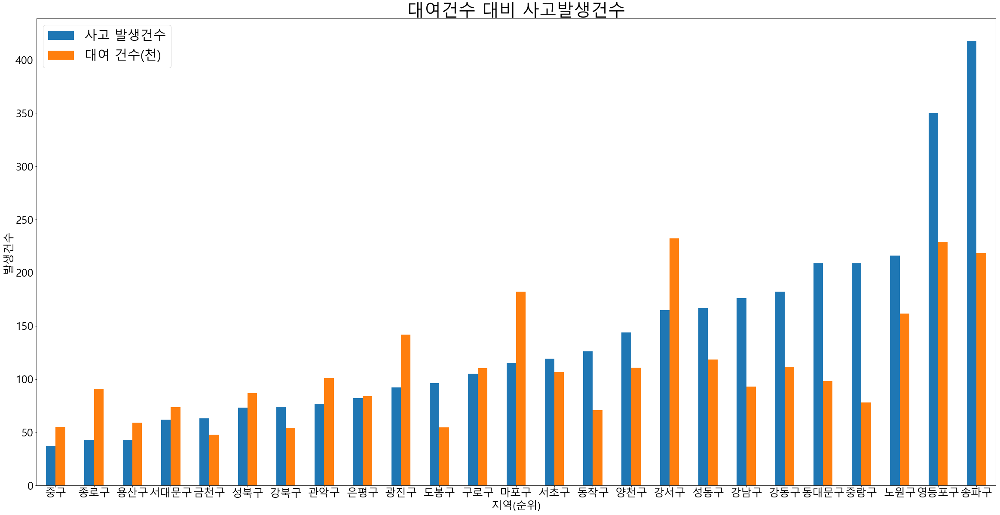

In [21]:
# CASE 1 : 사고 발생 건수 & 대여 건수 bar chart
result_using_accident[['사고 발생건수','대여 건수(천)']].sort_values(by='사고 발생건수').plot.bar(stacked=False,
                                                                                 figsize=(40,20), fontsize =25, rot =0)

plt.title('대여건수 대비 사고발생건수', fontsize =40)
plt.xlabel('지역(순위)', fontsize=25)
plt.ylabel('발생건수', fontsize=25)

plt.legend(fontsize = 30)
plt.savefig('대여건수대비사고발생건수.png')

In [18]:
# CASE 2 : 사고 발생건수 & 대여 건수 & 대여건수 대비 발생건수 점수 bar chart
# result_using_accident[['사고 발생건수','대여 건수(천)', '대여 건수 대비 사고 발생건수 점수']].sort_values(by='사고 발생건수').plot.bar(stacked=False, figsize=(40,20))

<br>

## 4. 도로종류 관련 사고발생

도로 종류별 도로 수와 도로 합계 순위

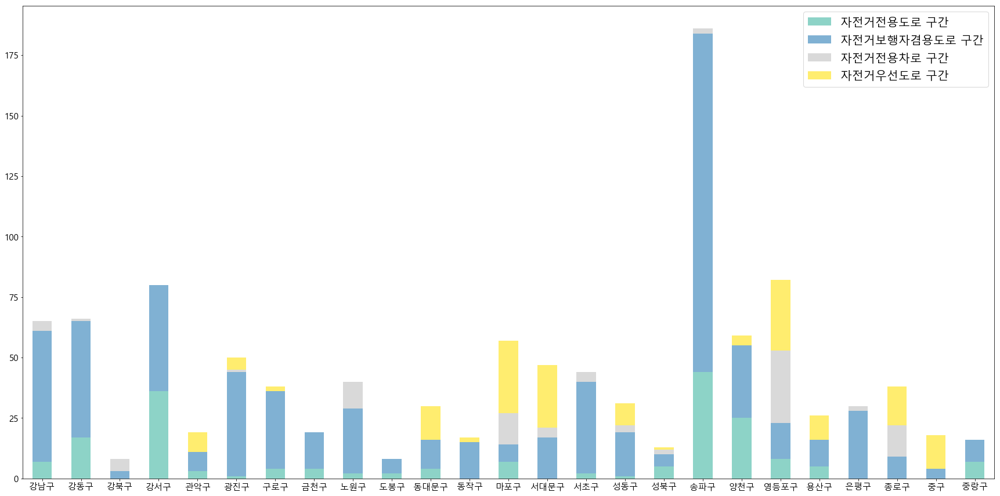

In [22]:
road_list = ['자전거전용도로 구간', '자전거보행자겸용도로 구간', '자전거전용차로 구간', '자전거우선도로 구간']

total_df[road_list].plot(kind="bar", stacked=True, figsize=(30, 15), fontsize=15, colormap='Set3', rot =0).legend(fontsize = 20)
plt.savefig('도로종류.png')

도로 종류의 비율

In [23]:
total_df_roadr = total_df[['자전거도로 합계 구간', '자전거전용도로 구간', '자전거보행자겸용도로 구간', '자전거전용차로 구간', '자전거우선도로 구간']]

# 각 종류별 합계 행 추가
total_df_roadr.loc['서울시'] = total_df_roadr.sum()

total_df_roadr.head()


D:\Programing\Anaconda\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


,자전거도로 합계 구간,자전거전용도로 구간,자전거보행자겸용도로 구간,자전거전용차로 구간,자전거우선도로 구간
강남구,65.0,7.0,54.0,4.0,0.0
강동구,66.0,17.0,48.0,1.0,0.0
강북구,8.0,0.0,3.0,5.0,0.0
강서구,80.0,36.0,44.0,0.0,0.0
관악구,19.0,3.0,8.0,0.0,8.0


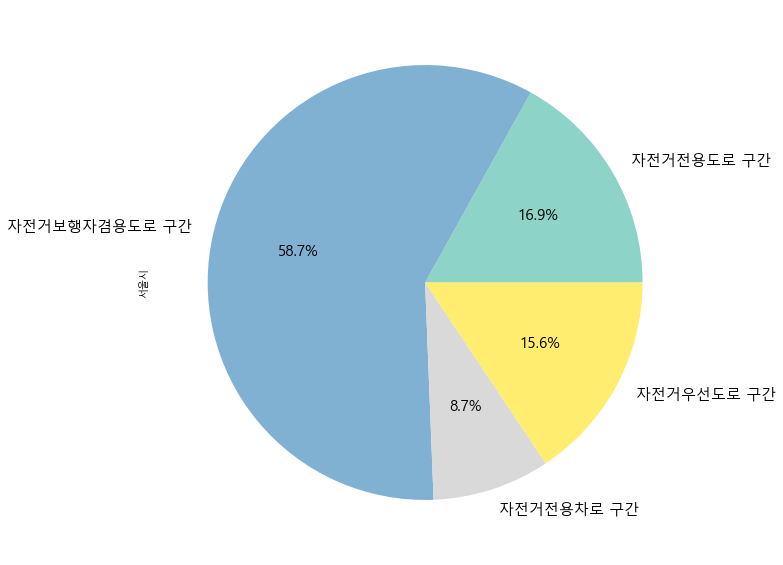

In [24]:
total_df_roadr.loc['서울시', road_list].plot(kind='pie', figsize=(15, 10), fontsize=15, colormap='Set3', autopct='%.1f%%')
plt.savefig('도로종류비율.png')

<br>

## 5. 자전거도로 지도 & 사고다발지역

자전거 도로 시각화

In [25]:
from folium.plugins import MarkerCluster
import folium.plugins

geo_path = 'data/yong/서울시자전거도로.geojson'
df_bic_road_geo = json.load(open(geo_path, encoding = 'utf-8'))

map = folium.Map(location=[37.5502, 126.982], zoom_start=11, tiles='Stamen Toner')



map.choropleth(geo_data = df_bic_road_geo,
               line_color = 'green',
               line_weight=2.5,
               line_opacity=1,
               key_on = 'feature.id') 


map.save('C:/자전거도로.html')

map



자전거도로 & 사고다발지역 시각화

In [26]:
legend_html = """
<div style="position:fixed;
     color : black;
     bottom: 50px; 
     left: 50px; 
     width: 140px; 
     height: 90px; 
     border:2px solid grey; 
     z-index: 9999;
     font-size:14px;">
     &nbsp;<b>Positive Cases:</b><br>
     &nbsp;<i class="fa fa-circle fa-1x" style="color:#298A08"></i>&nbsp;자전거도로구간<br><br>
     &nbsp;<i class="fa fa-circle fa-1x" style="color:red"></i>&nbsp;사고다발구간
</div>
"""

map.get_root().html.add_child(folium.Element(legend_html))

# 서울시 gugn(구군코드) query param 리스트
guGun_list2 = {
    '강남구': '680',
    '강동구': '740',
    '강북구': '305',
    '강서구': '500',
    '관악구': '620',
    '광진구': '215',
    '구로구': '530',
    '금천구': '545',
    '노원구': '350',
    '도봉구': '320',
    '동대문구': '230',
    '동작구': '590',
    '마포구': '440',
    '서대문구': '410',
    '서초구': '650',
    '성동구': '200',
    '성북구': '290',
    '송파구': '710',
    '양천구': '470',
    '영등포구': '560',
    '용산구': '170',
    '은평구': '380',
    '종로구': '110',
    '중구': '140',
    '중랑구': '260',
    '강서구': '4'
}

# query param
service_key = '#'
base_url = 'http://apis.data.go.kr/B552061/frequentzoneBicycle/getRestFrequentzoneBicycle'
searchYearCd = '2015'
siDo = '11'
type = 'xml'
numOfRows = '100'
pageNo = '1'

gu_nm = []
spot_nm = []
lat = []
lnd = []
    
for key, guGun in guGun_list2.items():
    request_url = base_url + '?' + "serviceKey=" + service_key + '&searchYearCd=' + searchYearCd + '&siDo=' + siDo + '&guGun=' + guGun+ '&type=' + type + '&numOfRows=' + numOfRows + '&pageNo=' + pageNo
    try:
        response = requests.get(request_url)
        soup = BeautifulSoup(response.text, 'lxml-xml')

        for value in soup.find('body').find_all('lo_crd'):
            gu_nm.append(key)
            lnd.append(value.get_text())
        for value in soup.find('body').find_all('la_crd'):
            lat.append(value.get_text())
        for item in soup.find('body').find_all('item'):
            spot_nm.append(item.find('spot_nm').get_text())
    except:
        pass

# 사고다발지역 위치 데이터프레임 생성
df_acc_prone = pd.DataFrame({'구별': gu_nm, '장소명': spot_nm, 'lat': lat, 'lnd': lnd})

map2 = folium.Map(location=[37.5502, 126.982], zoom_start=11)

# 사고다발지역 마커 추가
marker_cluster = MarkerCluster().add_to(map)
for n in df_acc_prone.index:
    folium.Circle(location=[float(df_acc_prone.lat[n]), float(df_acc_prone.lnd[n])], 
                  popup=df_acc_prone['장소명'][n], 
                  #color='red').add_to(marker_cluster)
                  color='red').add_to(map)
    

folium.LayerControl(collapsed=False)     


map

사고다발지역 클러스터링

In [27]:
for n in df_acc_prone.index:
    folium.Circle(location=[float(df_acc_prone.lat[n]), float(df_acc_prone.lnd[n])], 
                  popup=df_acc_prone['장소명'][n], 
                  color='red').add_to(marker_cluster)
                  #color='red').add_to(map)

folium.TileLayer('cartodbdark_matter').add_to(map)
    
folium.LayerControl().add_to(map)
map.save('C:/자전거도로사고다발구간.html')
map

<br>

# 데이터 스케일링


## 1. 점수화

In [25]:
total_df.head(0)

,자전거도로 합계 구간,자전거도로 합계 길이,자전거전용도로 구간,자전거전용도로 길이,자전거보행자겸용도로 구간,자전거보행자겸용도로 길이,자전거전용차로 구간,자전거전용차로 길이,자전거우선도로 구간,자전거우선도로 길이,가해자사고 발생건수,가해자사고 사망자수,가해자사고 부상자수,피해자사고 발생건수,피해자사고 사망자수,피해자사고 부상자수,사고 발생건수,인구수(만),대여건수(만)


In [28]:
def reRange(x, oldMin, oldMax, newMin, newMax):
    return (x - oldMin) * (newMax - newMin) / (oldMax - oldMin) + newMin

# 필요한 열 선택
df_heatmap = total_df[['자전거도로 합계 구간', '인구수(만)', '대여건수(만)', '사고 발생건수']]
df_heatmap.rename(columns = {'자전거도로 합계 구간': '도로 수',
                             '인구수(만)': '인구 수',
                             '대여건수(만)': '대여 건수',
                             '사고 발생건수': '사고 수'}, inplace=True)

# 점수 열 추가
for col in df_heatmap.columns:
    new_col = col + ' 점수'
    df_heatmap[new_col] = reRange(df_heatmap[col], min(df_heatmap[col]), max(df_heatmap[col]), 1, 100)

D:\Programing\Anaconda\lib\site-packages\pandas\core\frame.py:4025: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  return super(DataFrame, self).rename(**kwargs)
D:\Programing\Anaconda\lib\site-packages\ipykernel_launcher.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


요인별(도로 수 / 인구 수 / 대여 건수 / 사고 수) 점수 히트맵

D:\Programing\Anaconda\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


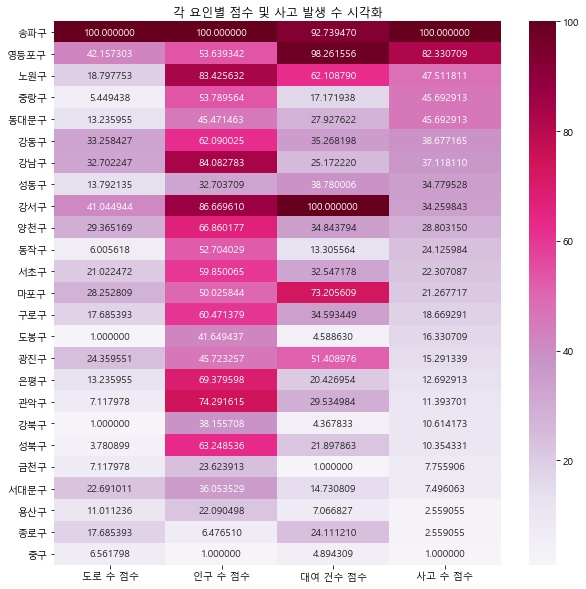

In [29]:
df_heatmap.sort_values(by='사고 수 점수', ascending=False, inplace=True)
plt.figure(figsize = (10,10))
sns.heatmap(df_heatmap[['도로 수 점수', '인구 수 점수', '대여 건수 점수', '사고 수 점수']], cmap='PuRd', fmt='f', annot=True)
plt.title('각 요인별 점수 및 사고 발생 수 시각화')
plt.savefig('요인별점수히트맵.png')

<br>

## 2. p-value

In [30]:
total_df_p = total_df[['자전거도로 합계 구간', '사고 발생건수']]
total_df_p.rename(columns = {'자전거도로 합계 구간':'자전거도로합계'},inplace=True)
total_df_p.corr()

D:\Programing\Anaconda\lib\site-packages\pandas\core\frame.py:4025: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  return super(DataFrame, self).rename(**kwargs)


,자전거도로합계,사고 발생건수
자전거도로합계,1.000000,0.757389
사고 발생건수,0.757389,1.000000



#### 각 도로 종류별 상관계수와 p-vale 계산

In [31]:
result = stats.pearsonr(total_df_p['자전거도로합계'], total_df_p['사고 발생건수'])
print('자전거도로 합계')
print('상관계수: {}'.format(result[0]))
print('p-value: {}'.format(result[1]))

자전거도로 합계
상관계수: 0.757388672620269
p-value: 1.1677899673918862e-05


In [32]:
result_1= stats.pearsonr(total_df['자전거보행자겸용도로 구간'], total_df_p['사고 발생건수'])
print('자전거보행자겸용도로')
print('상관계수: {}'.format(result_1[0]))
print('p-value: {}'.format(result_1[1]))

자전거보행자겸용도로
상관계수: 0.6474735179653052
p-value: 0.0004673925268872105


In [33]:
result_2= stats.pearsonr(total_df['자전거전용도로 구간'], total_df_p['사고 발생건수'])
print('자전거전용도로')
print('상관계수: {}'.format(result_2[0]))
print('p-value: {}'.format(result_2[1]))

자전거전용도로
상관계수: 0.6090850084832357
p-value: 0.0012314971563196781


In [34]:
result_3= stats.pearsonr(total_df['자전거전용차로 구간'], total_df_p['사고 발생건수'])
print('자전거전용차로')
print('상관계수: {}'.format(result_3[0]))
print('p-value: {}'.format(result_3[1]))

자전거전용차로
상관계수: 0.3713472876589969
p-value: 0.06760028816487902


In [35]:
result_4= stats.pearsonr(total_df['자전거우선도로 구간'], total_df_p['사고 발생건수'])
print('자전거우선도로')
print('상관계수: {}'.format(result_4[0]))
print('p-value: {}'.format(result_4[1]))

자전거우선도로
상관계수: 0.0024256092120915657
p-value: 0.9908188567964246


각 도로별 상관계수, p-value 비교

자전거보행자겸용도로: 0.6474735179653052 / 0.0004673925268872105
자전거우선도로: 0.0024256092120915657 / 0.9908188567964246
자전거전용도로: 0.6090850084832357 / 0.0012314971563196781
자전거전용차로: 0.3713472876589969 / 0.06760028816487902


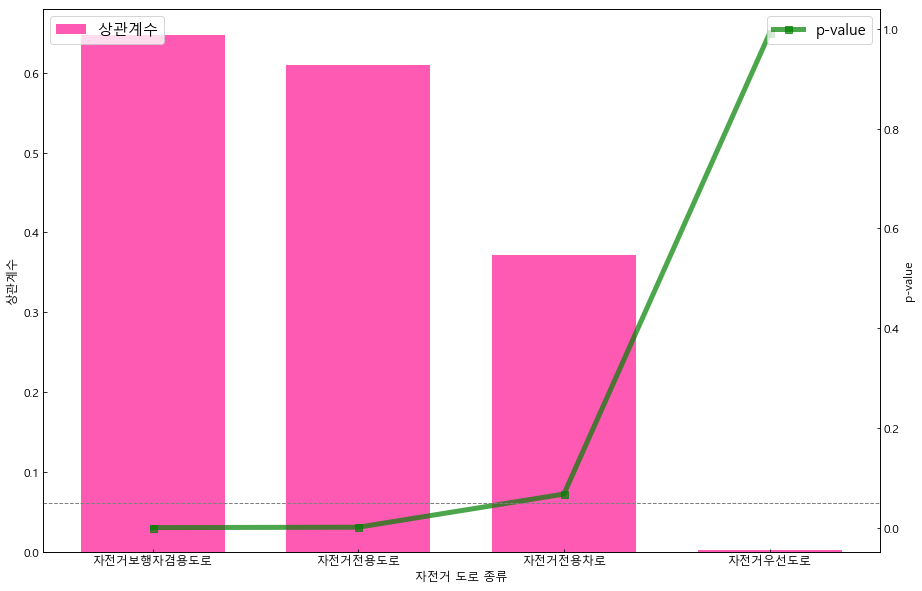

In [37]:
# 각 도로 종류별 상관계수, p-value 계산
col_list = ['자전거전용도로 구간', '자전거보행자겸용도로 구간', '자전거전용차로 구간', '자전거우선도로 구간', "사고 발생건수"]
df_road_corr = total_df[col_list]

nm_list = ['자전거보행자겸용도로', '자전거우선도로', '자전거전용도로', '자전거전용차로']
corr_list = []
p_value_list = []

# 데이터프레임 생성
for item in nm_list:
    result_all = stats.pearsonr(df_road_corr[item + ' 구간'], df_road_corr['사고 발생건수'])
    print('{}: {} / {}'.format(item, result_all[0], result_all[1]))
    corr_list.append(result_all[0]) # 상관계수
    p_value_list.append(result_all[1]) # p-value
    
df_corr = pd.DataFrame({'도로 종류': nm_list, '상관계수': corr_list, 'p-value': p_value_list})
df_corr.sort_values(by='상관계수', ascending=False, inplace=True)

# 데이터 준비
x = df_corr['도로 종류']
y1 = df_corr['상관계수']
y2 = df_corr['p-value']

# 기본 설정
plt.rcParams['figure.figsize'] = (15,10)
plt.rcParams['font.size'] = 12

# 그래프
fig, ax1 = plt.subplots()

# 막대그래프 - 상관계수
ax1.bar(x, y1, color='deeppink', label='상관계수', alpha=0.7, width=0.7)
# ax1.plot(x, y1, '-s', color='green', markersize=7, linewidth=5, alpha=0.7, label='상관계수')
ax1.set_xlabel('자전거 도로 종류')
ax1.set_ylabel('상관계수')
ax1.tick_params(axis='both', direction='in')

# 꺾은선그래프 - p-value
ax2 = ax1.twinx()
ax2.plot(x, y2, '-s', color='green', markersize=7, linewidth=5, alpha=0.7, label='p-value')
# ax1.bar(x, y1, color='deeppink', label='', alpha=0.7, width=0.7)
ax2.set_ylabel('p-value')
ax2.tick_params(axis='y', direction='in')

ax1.legend(loc='upper left', fontsize=15)
ax2.legend(loc='upper right', fontsize=15)

# p-value 기준값
plt.axhline(0.05, color='gray', linestyle='--', linewidth='1', label='ddd')

plt.savefig('도로별Pvalue.png')
plt.show()


---

<br>

# 결론

자전거 와 보행자 도로간의 행정적 보여주기식 구분이 아닌 통행로의 확실한
분리가 자전거 교통사고 감소에 가장큰 요인을 줄이는 것이라 생각합니다.